In [1]:
import matplotlib.pyplot as plt
import numpy as np
from astropy.io import fits
from glob import glob
import os
from astropy.visualization import ZScaleInterval, ImageNormalize
from astropy.convolution import Gaussian2DKernel,convolve, convolve_fft
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import h5py
import copy

In [2]:
green_path = "/Users/yjzhu/Desktop/Solar/Eclipse2017/src/EclipseSpectra2017/MikesData/VaderEclipseDayGreen2017aug21/"
red_path = "/Users/yjzhu/Desktop/Solar/Eclipse2017/src/EclipseSpectra2017/MikesData/VaderEclipseDayRed2017aug21/"
fname_dark_green_1s = ["DarkFrameGreen1s_21353.fit","DarkFrameGreen1s_21355.fit","DarkFrameGreen1s_21399.fit",
                    "DarkFrameGreen1s_21400.fit","DarkFrameGreen1s_21405.fit","DarkFrameGreen1s_22954.fit",
                    "DarkFrameGreen1s.fit"]

In [3]:
with fits.open("../../src/EclipseSpectra2017/MikesData/VaderEclipseDayGreen2017aug21/DarkFrameGreen1s_21353.fit") as hdul:
    print(hdul[0].data.shape)

(1040, 1392)


In [4]:
class DarkFrameStack:
    def __init__(self,filenames,dir=None):
        self.filenames = filenames
        if dir is not None:
            filepaths = [os.path.join(dir, filename_) for filename_ in filenames]
        else:
            filepaths = filenames
        
        self.n_stack = len(filepaths)
        self.nx = 1392
        self.ny = 1040
        self.image_cube = np.zeros((self.ny,self.nx,self.n_stack))
        self.headers = []

        for ii, filepath in enumerate(filepaths):
            with fits.open(filepath) as hdul:
                self.image_cube[:,:,ii] = hdul[0].data
                self.headers.append(hdul[0].header)
        
        self.bias_aver = np.mean(self.image_cube,axis=2)

    def calculate_bias(self,mask_hot=True,mask_sigma=5,kernel_std=1):
        gaussian_2D_kernel = Gaussian2DKernel(kernel_std)
        if mask_hot is True:
            threshold = np.mean(self.bias_aver) + mask_sigma*np.std(self.bias_aver)
            print("masked pixels with values > {:.0f}".format(threshold))
            mask_pixel = np.where(self.bias_aver > threshold)
            self.bias_smooth = copy.deepcopy(self.bias_aver)
            self.bias_smooth[mask_pixel] = np.nan
        self.bias_smooth = convolve(self.bias_smooth, gaussian_2D_kernel,boundary='extend')

    

    def plot_all(self,scale="Zscale"):
        fig, axes = plt.subplots(self.n_stack,1,figsize=(8,6*self.n_stack + 2),
                    constrained_layout=True)
        
        for ii, ax_ in enumerate(axes):
            if scale == "Zscale":
                norm = ImageNormalize(self.image_cube[:,:,ii], interval=ZScaleInterval())
            else:
                norm = None
            im = ax_.pcolormesh(np.arange(self.nx),np.arange(self.ny),self.image_cube[:,:,ii],
                            cmap="Greys_r",norm=norm,shading='auto',rasterized=True)
            ax_.axis("scaled")
            ax_.set_title(self.filenames[ii])
            
            clb_ax = inset_axes(ax_,width="3%",height= "100%",loc='lower left',
                bbox_to_anchor=(1.02, 0., 1, 1),
                 bbox_transform=ax_.transAxes,
                 borderpad=0)
            clb = plt.colorbar(im,pad = 0.05,orientation='vertical',ax=ax_,cax=clb_ax)
            #clb.yaxis.set_minor_locator(AutoMinorLocator(5))

    def plot_all_hist(self):
        fig, ax = plt.subplots(figsize=(8,6))

        ax.hist(self.image_cube.reshape(-1,self.n_stack),bins=np.linspace(750,1050,40),histtype="step",label=self.filenames)
        ax.legend()

        return ax

    def plot_bias(self,hist_min=750,hist_max=1000,scale="Zscale"):
        fig, (ax1,ax2) = plt.subplots(2,1,figsize=(8,12),constrained_layout=True)
        if scale == "Zscale":
            norm = ImageNormalize(self.bias_aver, interval=ZScaleInterval())
        else:
            norm = None
        im = ax1.pcolormesh(np.arange(self.nx),np.arange(self.ny),self.bias_aver,
                            cmap="Greys_r",norm=norm,shading='auto',rasterized=True)
        clb_ax = inset_axes(ax1,width="3%",height= "100%",loc='lower left',
                bbox_to_anchor=(1.02, 0., 1, 1),
                 bbox_transform=ax1.transAxes,
                 borderpad=0)
        clb = plt.colorbar(im,pad = 0.05,orientation='vertical',ax=ax1,cax=clb_ax)

        ax2.hist(self.bias_aver.flatten(),bins=np.linspace(hist_min,hist_max,40),histtype="step")

        return ax1, ax2

    def plot_bias_smooth(self,hist_min=750,hist_max=1000,scale="Zscale"):
        fig, (ax1,ax2) = plt.subplots(2,1,figsize=(8,12),constrained_layout=True)
        if scale == "Zscale":
            norm = ImageNormalize(self.bias_smooth, interval=ZScaleInterval())
        else:
            norm = None
        im = ax1.pcolormesh(np.arange(self.nx),np.arange(self.ny),self.bias_smooth,
                            cmap="Greys_r",norm=norm,shading='auto',rasterized=True)
        clb_ax = inset_axes(ax1,width="3%",height= "100%",loc='lower left',
                bbox_to_anchor=(1.02, 0., 1, 1),
                 bbox_transform=ax1.transAxes,
                 borderpad=0)
        clb = plt.colorbar(im,pad = 0.05,orientation='vertical',ax=ax1,cax=clb_ax)

        ax2.hist(self.bias_smooth.flatten(),bins=np.linspace(hist_min,hist_max,40),histtype="step")

        return ax1, ax2
        


### Dark Frame Green 1s
---

In [5]:
dark_green_1s_stack = DarkFrameStack(fname_dark_green_1s,green_path)

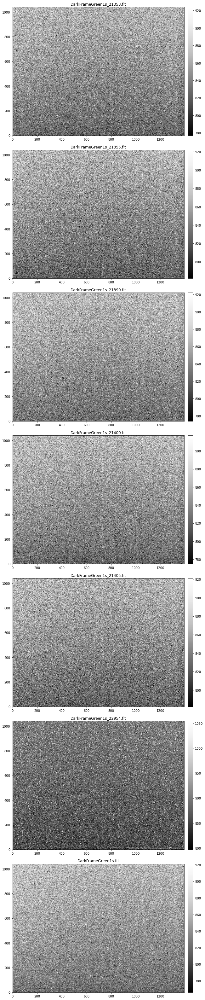

In [6]:
dark_green_1s_stack.plot_all()

<AxesSubplot:>

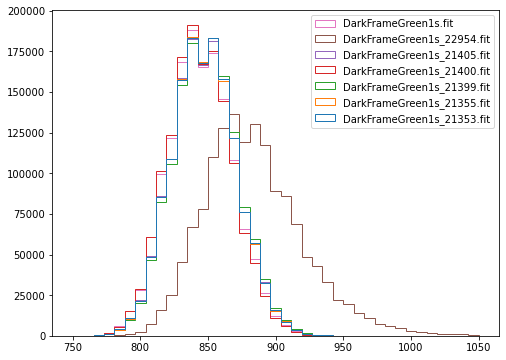

In [7]:
dark_green_1s_stack.plot_all_hist()

In [8]:
fname_dark_green_1s_final = ["DarkFrameGreen1s_21353.fit","DarkFrameGreen1s_21355.fit","DarkFrameGreen1s_21399.fit",
                    "DarkFrameGreen1s_21400.fit","DarkFrameGreen1s_21405.fit",
                    "DarkFrameGreen1s.fit"]

In [9]:
dark_green_1s_stack_final = DarkFrameStack(fname_dark_green_1s_final,green_path)

Text(0.5, 1.0, 'Bias from 1s Dark Frames')

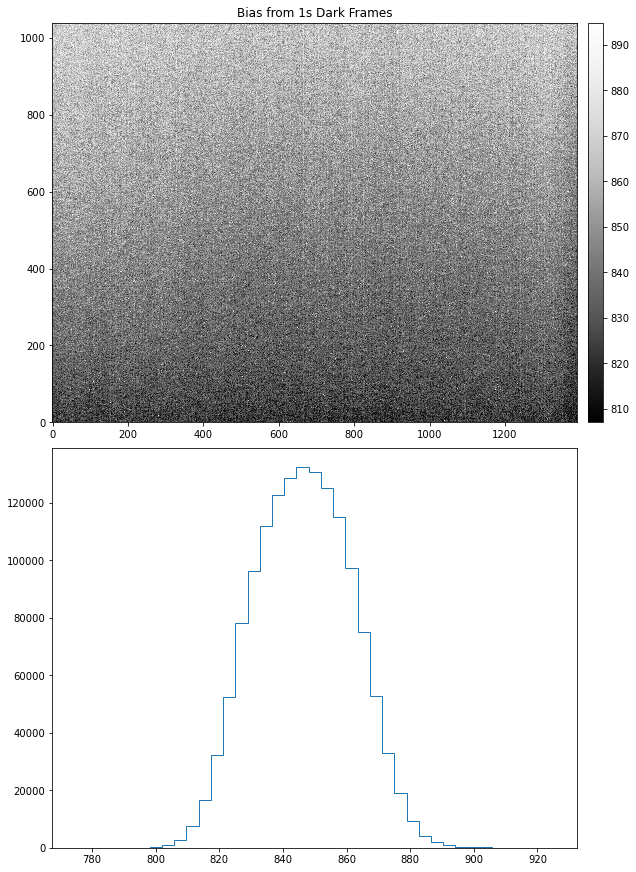

In [10]:
ax1, ax2 = dark_green_1s_stack_final.plot_bias(hist_min=775,hist_max=925,scale="Zscale")
ax1.set_title("Bias from 1s Dark Frames")

masked pixels with values > 1051


Text(0.5, 1.0, 'Smoothed Bias from 1s Dark Frames')

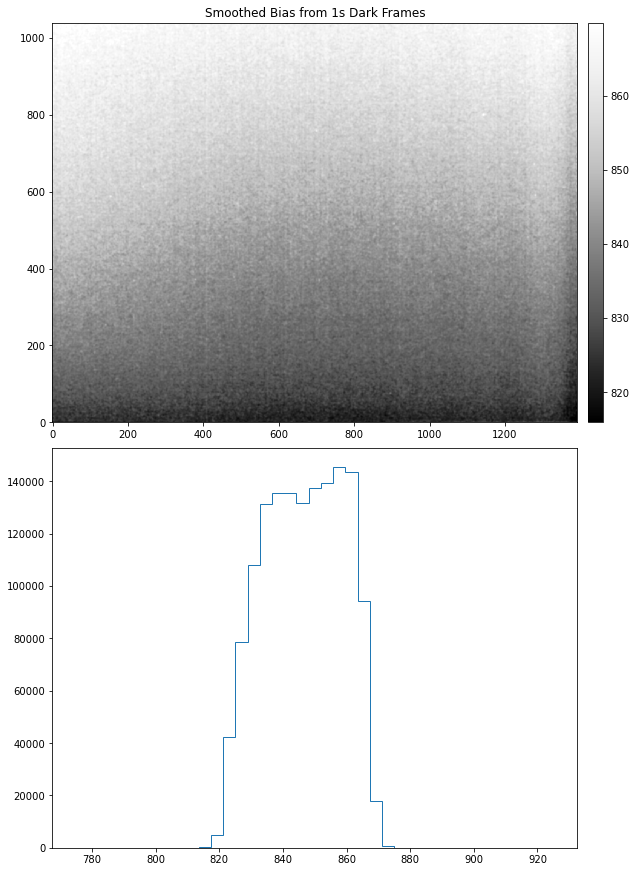

In [11]:
dark_green_1s_stack_final.calculate_bias(kernel_std=2,mask_sigma=3)
ax1, ax2 = dark_green_1s_stack_final.plot_bias_smooth(hist_min=775,hist_max=925,scale="Zscale")
ax1.set_title("Smoothed Bias from 1s Dark Frames")

In [12]:
bias_green_1s = dark_green_1s_stack_final.bias_smooth
with h5py.File("../../sav/Eclipse/Bias/master_bias_dc_green_1s_proto.h5", 'w') as hf:
    hf.create_dataset("image",  data=bias_green_1s)

### Dark Frame Green 2s
---

In [13]:
fname_dark_green_2s = ["DarkFrameGreen2s_21285.fit","DarkFrameGreen2s_21287.fit","DarkFrameGreen2s_21288.fit","DarkFrameGreen2s_21289.fit",
                    "DarkFrameGreen2s_21290.fit","DarkFrameGreen2s_21292.fit","DarkFrameGreen2s_21293.fit","DarkFrameGreen2s_21295.fit",
                    "DarkFrameGreen2s_21296.fit","DarkFrameGreen2s_21297.fit","DarkFrameGreen2s_21298.fit","DarkFrameGreen2s_21299.fit",
                    "DarkFrameGreen2s_21300.fit","DarkFrameGreen2s_21302.fit","DarkFrameGreen2s_21303.fit"]

In [14]:
dark_green_2s_stack = DarkFrameStack(fname_dark_green_2s,green_path)

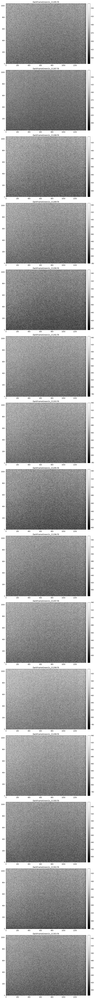

In [15]:
dark_green_2s_stack.plot_all()

<AxesSubplot:>

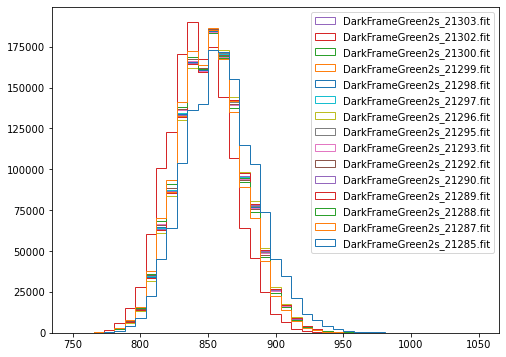

In [16]:
dark_green_2s_stack.plot_all_hist()

In [17]:
fname_dark_green_2s_final = ["DarkFrameGreen2s_21287.fit","DarkFrameGreen2s_21288.fit","DarkFrameGreen2s_21289.fit",
                    "DarkFrameGreen2s_21290.fit","DarkFrameGreen2s_21292.fit","DarkFrameGreen2s_21293.fit","DarkFrameGreen2s_21295.fit",
                    "DarkFrameGreen2s_21296.fit","DarkFrameGreen2s_21297.fit","DarkFrameGreen2s_21298.fit","DarkFrameGreen2s_21299.fit",
                    "DarkFrameGreen2s_21300.fit","DarkFrameGreen2s_21303.fit"]

In [18]:
dark_green_2s_stack_final = DarkFrameStack(fname_dark_green_2s_final,green_path)

Text(0.5, 1.0, 'Bias from 2s Dark Frames')

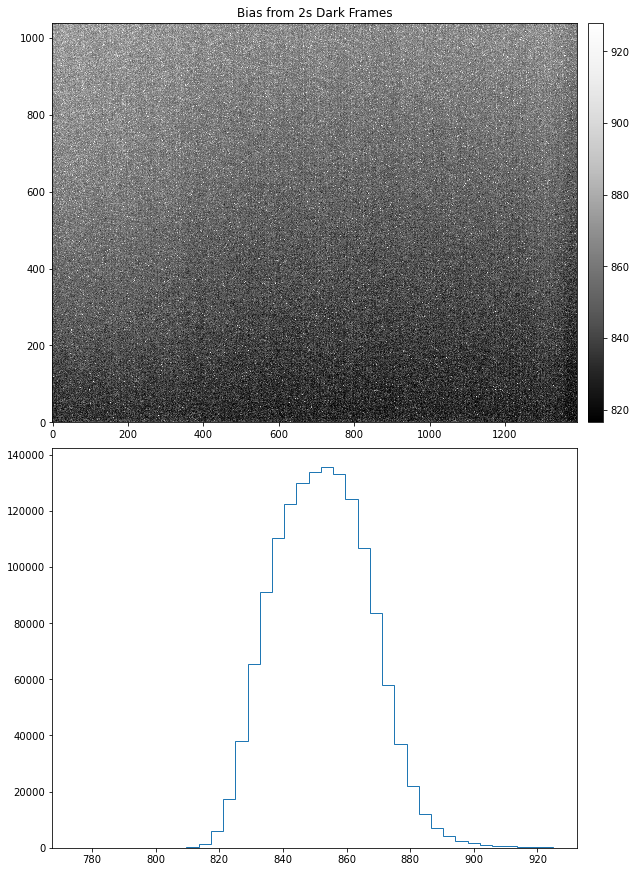

In [19]:
ax1, _ = dark_green_2s_stack_final.plot_bias(hist_min=775,hist_max=925)
ax1.set_title("Bias from 2s Dark Frames")

masked pixels with values > 1090


Text(0.5, 1.0, 'Bias from 2s Dark Frames')

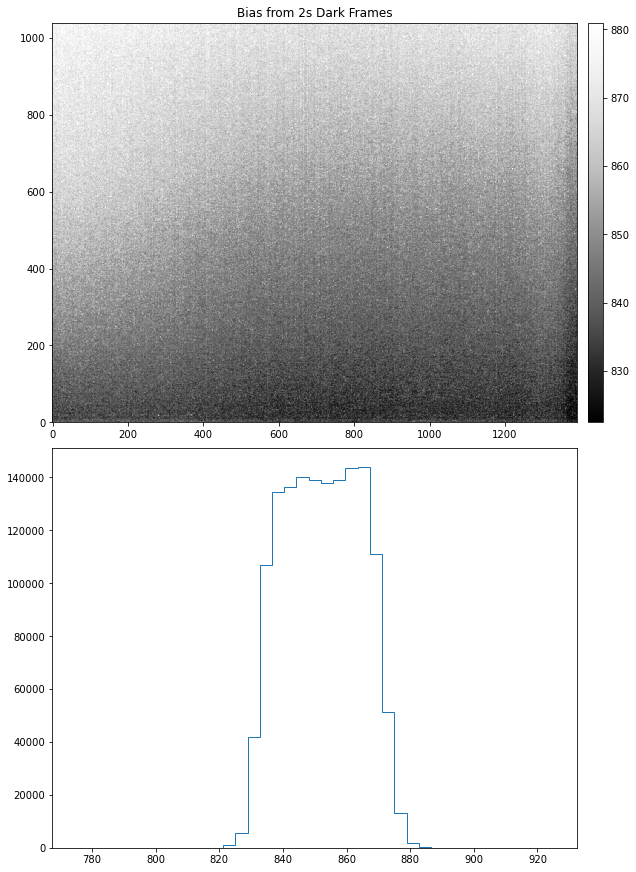

In [20]:
dark_green_2s_stack_final.calculate_bias(mask_sigma=3, kernel_std=1)
ax1, _ = dark_green_2s_stack_final.plot_bias_smooth(hist_min=775,hist_max=925)
ax1.set_title("Bias from 2s Dark Frames")

In [21]:
bias_green_2s = dark_green_2s_stack_final.bias_smooth
with h5py.File("../../sav/Eclipse/Bias/master_bias_dc_green_2s_proto.h5", 'w') as hf:
    hf.create_dataset("image",  data=bias_green_2s)

In [22]:
fname_dark_green_3s = ["DarkFrameGreen3s_21281.fit","DarkFrameGreen3s_21230.fit","DarkFrameGreen3s_21231.fit","DarkFrameGreen3s_21233.fit",
                    "DarkFrameGreen3s_21234.fit","DarkFrameGreen3s_21235.fit","DarkFrameGreen3s_21236.fit","DarkFrameGreen3s_21237.fit",
                    "DarkFrameGreen3s_21238.fit","DarkFrameGreen3s_21239.fit","DarkFrameGreen3s_21241.fit","DarkFrameGreen3s_21242.fit",
                    "DarkFrameGreen3s_21243.fit","DarkFrameGreen3s_21244.fit","DarkFrameGreen3s_21245.fit"]

In [23]:
dark_green_3s_stack = DarkFrameStack(fname_dark_green_3s,green_path)

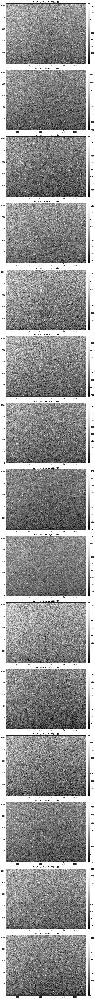

In [24]:
dark_green_3s_stack.plot_all()

<AxesSubplot:>

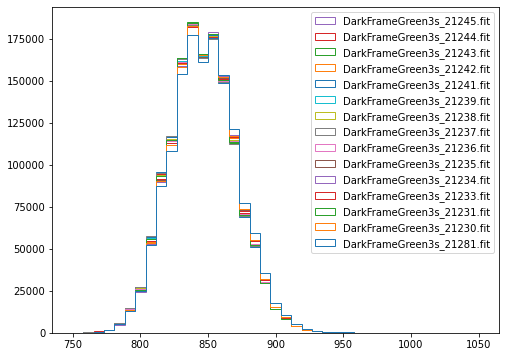

In [25]:
dark_green_3s_stack.plot_all_hist()

masked pixels with values > 1135


Text(0.5, 1.0, 'Bias + Dark Current from 3s Dark Frames')

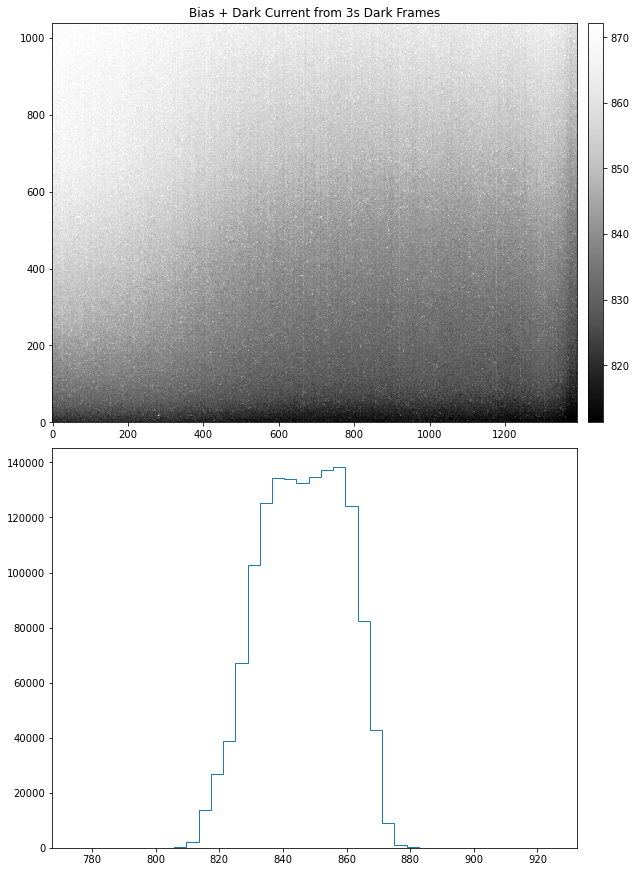

In [26]:
dark_green_3s_stack.calculate_bias(mask_sigma=3,kernel_std=1)
ax1, _ = dark_green_3s_stack.plot_bias_smooth(hist_min=775,hist_max=925)
ax1.set_title("Bias + Dark Current from 3s Dark Frames")

In [27]:
bias_green_3s = dark_green_3s_stack.bias_smooth
with h5py.File("../../sav/Eclipse/Bias/master_bias_dc_green_3s_proto.h5", 'w') as hf:
    hf.create_dataset("image",  data=bias_green_3s)

In [28]:
fname_dark_green_5s = ["DarkFrameGreen5s_21081.fit","DarkFrameGreen5s_21082.fit","DarkFrameGreen5s_21083.fit","DarkFrameGreen5s_21084.fit",
                    "DarkFrameGreen5s_21085.fit","DarkFrameGreen5s_21086.fit","DarkFrameGreen5s_21087.fit","DarkFrameGreen5s_21088.fit",
                    "DarkFrameGreen5s_21089.fit","DarkFrameGreen5s_21090.fit","DarkFrameGreen5s_21091.fit","DarkFrameGreen5s_21092.fit",
                    "DarkFrameGreen5s_21093.fit","DarkFrameGreen5s_21094.fit","DarkFrameGreen5s_21095.fit","DarkFrameGreen5s_21096.fit",
                    "DarkFrameGreen5s_21097.fit","DarkFrameGreen5s_21098.fit","DarkFrameGreen5s_21099.fit","DarkFrameGreen5s_21100.fit"]

In [29]:
dark_green_5s_stack = DarkFrameStack(fname_dark_green_5s,green_path)

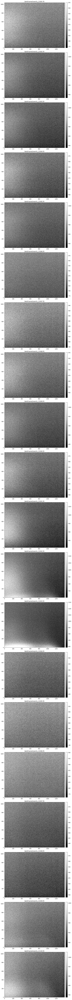

In [30]:
dark_green_5s_stack.plot_all()

<AxesSubplot:>

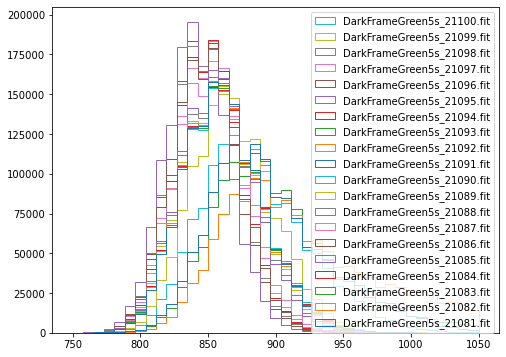

In [31]:
dark_green_5s_stack.plot_all_hist()